The following code helps you visualize the submarine data and contains the crucial information about the data such as size of measurement domain, number of grid points and frequency modes etc. 

Our first task is to import the data into python (similarly MATLAB). Three files are available, "subdata.npy" is a numpy binary file most conveninet for Python users. "subtata.mat" is best if you plan to use MATLAB and "subdata.csv" is the same data in text format if you are having trouble with the other formats. In MATLAB you can simply use the load command. In Python, and in particular if you are using something like Colab you need some utilities to load the data. Here's a small snippet for loading data from your Google drive.   

In [1]:
import numpy as np

import plotly
import plotly.graph_objs as go
from IPython.display import clear_output

In [2]:
data_path = 'data/subdata.npy'

subdata = np.load(data_path) # huge matrix of size 262144 x 49 (columns contain flattened 3d matrix of size 64x64x64)

In [3]:
# plot the data in time 

# NOTE: L we defined in class is 2Lh here, i.e. the domain here is [-Lh,Lh].
Lh = 10; # length of spatial domain (cube of side L = 2*10). 
N_grid = 64; # number of grid points/Fourier modes in each direction
xx = np.linspace(-Lh, Lh, N_grid+1) #spatial grid in x dir
x = xx[0:N_grid]
y = x # same grid in y,z direction
z = x

K_grid = (2*np.pi/(2*Lh))*np.linspace(-N_grid/2, N_grid/2 -1, N_grid) # frequency grid for one coordinate

xv, yv, zv = np.meshgrid( x, y, z) # generate 3D meshgrid for plotting

# plot iso surfaces for every third measurement

for j in range(0,49,3):

  signal = np.reshape(subdata[:, j], (N_grid, N_grid, N_grid))
  normal_sig_abs = np.abs(signal)/np.abs(signal).max()

  # generate data for isosurface of the 3D data 
  fig_data = go.Isosurface( x = xv.flatten(), y = yv.flatten(), z = zv.flatten(),
                           value = normal_sig_abs.flatten(), isomin=0.6, isomax=1)

  # generate plots
  clear_output(wait=True) # need this to discard previous figs
  fig = go.Figure( data = fig_data )
  fig.show()


In [4]:
import matplotlib.pyplot as plt

/Users/hunterlybbert/.pyenv/versions/uw-dev-env/lib/python3.11/site-packages/matplotlib/cbook.py:1762: ComplexWarning:

Casting complex values to real discards the imaginary part

/Users/hunterlybbert/.pyenv/versions/uw-dev-env/lib/python3.11/site-packages/matplotlib/cbook.py:1398: ComplexWarning:

Casting complex values to real discards the imaginary part



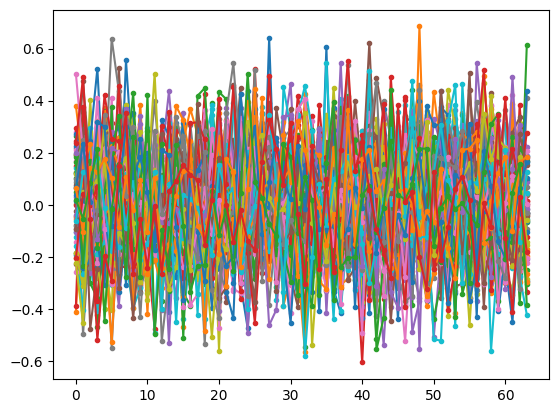

In [5]:
first = subdata[:,0]

plt.plot(first.reshape((64,64,64))[:,:,0], marker='.')
plt.show()

In [19]:
import matplotlib.pyplot as plt

def plot_3d(data, n):
    signal = np.reshape(subdata[:, n], (N_grid, N_grid, N_grid))
    normal_sig_abs = np.abs(signal)/np.abs(signal).max()

    # generate data for isosurface of the 3D data 
    fig_data = go.Isosurface( x = xv.flatten(), y = yv.flatten(), z = zv.flatten(),
                            value = normal_sig_abs.flatten())#, isomin=.6, isomax=1)
                            # value = signal.real.flatten(), isomin=.6, isomax=1)

    # generate plots
    clear_output(wait=True) # need this to discard previous figs
    fig = go.Figure( data = fig_data )
    fig.show()       

plot_3d(subdata.reshape(64,64,64,49), 48)

In [45]:
abs(subdata.reshape(64,64,64,49)[:,:,:,0]) < 1e-6

array([[[False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        ...,
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False]],

       [[False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        ...,
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False]],

       [[False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        ...,
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, Fal

In [43]:
np.array(
    [
        (
            subdata.reshape(64,64,64,49)[:,:,:,i] < 1e-6
        ).sum()
        for i in range(49)
    ]
).mean()

np.float64(131115.81632653062)

In [33]:
subdata.reshape(64,64,64,49)[:,:,:,0].shape

(64, 64, 64)

In [34]:
64**3

262144